# Clean viz 

Producing a clean visualization to present 

-------------------

#### Bus stop example

In [20]:
# import sys
# !{sys.executable} -m pip install folium matplotlib mapclassify

In [7]:
import geopandas as gpd
import pandas as pd
import polars as pl

In [12]:
def merge_areas_by_time(gdf_stops_reach_areas: gpd.GeoDataFrame) -> gpd.GeoDataFrame: 
    """
    Takes all the reachable areas for stop-pid-time combination and merges
    the shape by stop-time. 
    """

    # Standardize column names and clean time labels
    gdf_stop_areas = gdf_stops_reach_areas.rename(columns={"stpid": "stop_id"})

    # TODO: Apply dissolved grouped by stop_id and time budget
    gdf_dissolved = gdf_stop_areas.dissolve(by = "time_budget").reset_index()
    gdf_dissolved = gdf_stop_areas

    # logging.info(f"{gdf_dissolved = }")

    gdf_dissolved["minutes"] = gdf_dissolved["time_budget"].transform(
        lambda x: x.seconds / 60
    )

    # TODO: Pasar implementación a vectores con los valores del tiempo 
    gdf_dissolved["time_label"] = gdf_dissolved["minutes"].case_when(
        [
            (gdf_dissolved.eval(f"minutes == {str(2)}"), "2 minutes"), 
            (gdf_dissolved.eval(f"minutes == {str(5)}"), "5 minutes"), 
            (gdf_dissolved.eval(f"minutes == {str(10)}"), "10 minutes"), 
            (gdf_dissolved.eval(f"minutes == {str(15)}"), "15 minutes"),
            (gdf_dissolved.eval(f"minutes == {str(30)}"), "30 minutes"),
            (gdf_dissolved.eval(f"minutes == {str(60)}"), "1 hour"),
            (gdf_dissolved.eval(f"minutes == {str(90)}"), "1 hour 30 minutes"),
            (gdf_dissolved.eval(f"minutes == {str(120)}"), "2 hours")
        ]
    )


    # gdf_dissolved["time_label"] = pd.Categorical(gdf_dissolved["time_label"], 
    #                                               categories = ["2 minutes", 
    #                                                             "5 minutes",
    #                                                             "10 minutes", 
    #                                                             "15 minutes"])

    
    gdf_dissolved["time_label"] = pd.Categorical(gdf_dissolved["time_label"], 
                                                  categories = [ 
                                                                "5 minutes", 
                                                                "10 minutes", 
                                                                "15 minutes",
                                                                "30 minutes",
                                                                "1 hour",
                                                                "1 hour 30 minutes",
                                                                "2 hours"])

    return gdf_dissolved

In [13]:
gdf73 = gpd.read_parquet("out/stops_parquets/73_copy.parquet")
gdf73 = merge_areas_by_time(gdf73)
gdf73.head(3)
gdf73 = gdf73.drop(columns = ["time_budget"])
gdf73 = gdf73.sort_values("minutes")
gdf73 = gdf73.iloc[::-1] # Decreasing order

<Axes: >

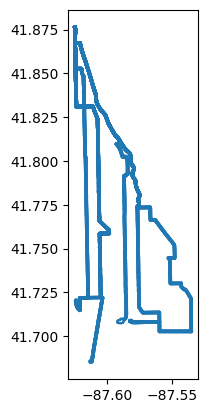

In [17]:
gdf73.boundary.plot()

In [23]:
gdf73.explore(column = "time_label",
              # cmap = "RdYlGn_r",
            # cmap = "Greens_r",
            cmap = "YlGn_r",
            # cmap = "summer",
              opacity = 0.1,
              tiles="CartoDB positron")

-----------------
# Community level map 
Bridgeport

In [7]:
gdf_community = gpd.read_parquet("stop_access_shapes_bridgeport.parquet")
gdf_community = gdf_community.drop(columns = ["time_budget"])
gdf_community = gdf_community.sort_values("minutes")
gdf_community = gdf_community.iloc[::-1] # Decreasing order
gdf_community.head(5)

,geometry,segments,length_ft,ls_geometry,pid,origin_stop,minutes,time_label
0,"POLYGON ((-87.66506 41.83768, -87.66511 41.837...",0,0.0,POINT (-87.65891 41.84131),7124,4476,120.0,2 hours
0,"POLYGON ((-87.64701 41.84339, -87.64704 41.845...",0,0.0,POINT (-87.64616 41.83636),10949,5908,120.0,2 hours
0,"POLYGON ((-87.64701 41.84339, -87.64704 41.845...",0,0.0,POINT (-87.64616 41.83635),10954,5908,120.0,2 hours
0,"POLYGON ((-87.64202 41.83854, -87.64202 41.838...",0,0.0,POINT (-87.64129 41.83438),7014,5104,120.0,2 hours
0,"POLYGON ((-87.65027 41.83024, -87.65028 41.830...",0,0.0,POINT (-87.65056 41.83064),14102,18205,120.0,2 hours


In [29]:
gdf_community.explore(column = "time_label", 
              cmap = "RdYlGn_r", 
              tiles="CartoDB positron")

In [21]:
# Date formatting 
from datetime import datetime, timedelta
td = timedelta(days=2, hours=3, minutes=5, seconds=8, microseconds=340)
td

hours, remainder = divmod(td.total_seconds(), 3600)
minutes, seconds = divmod(remainder, 60)

td = datetime.now()

# This is the needed f string formatting 
print(f"{td:%M minutes}")
print(f"{td:%H hour %M minutes}")


04 minutes
14 hour 04 minutes


In [28]:
# 
gdf_community["time_label"] = gdf_community["minutes"].case_when(
    [(gdf_community.eval("minutes < 60"), "Less than an hour"),
    (gdf_community.eval("minutes >= 60"), "More than an hour")]    
)

gdf_community["minutes"][gdf_community["minutes"] < 60] = 


0    30.0
0    30.0
0    30.0
0    30.0
0    30.0
     ... 
0     5.0
0     5.0
0     5.0
0     5.0
0     5.0
Name: minutes, Length: 1732, dtype: float64

-----------------
# Continuous map

In [36]:
gdf73 = gpd.read_parquet("out/stops_parquets/73_continuous.parquet")

print(gdf73.columns)

# gdf73["time_to_previous"] = gdf73["time_to_previous"].astype(str)
# gdf73["travel_time_elapsed"] = gdf73["travel_time_elapsed"].astype(str)

gdf73["time_to_previous"] = gdf73["time_to_previous"].dt.seconds / 60
gdf73["travel_time_elapsed"] = gdf73["travel_time_elapsed"].dt.seconds / 60


Index(['rt', 'pid', 'stop_sequence', 'stop_id', 'period_value',
       'time_to_previous', 'travel_time_elapsed', 'route', 'lat', 'lon', 'typ',
       'stpnm', 'pdist', 'geometry', 'segment', 'p_stp_id', 'segment_geom'],
      dtype='object')


In [ ]:

gdf73.explore(column = "travel_time_elapsed",
              cmap = "RdYlGn",
            # cmap = "Greens_r",
            # cmap = "YlGn_r",
            # cmap = "summer",
              opacity = 1,
              tiles="CartoDB positron")

In [ ]:
gdf73["travel_time_elapsed"] = gdf73["travel_time_elapsed"].astype(str)


gdf73.explore(column = "travel_time_elapsed",
              cmap = "RdYlGn",
            # cmap = "Greens_r",
            # cmap = "YlGn_r",
            # cmap = "summer",
              opacity = 1,
              tiles="CartoDB positron")